**About**



This competition wants us to create an efficient and reliable method to detect secret data hidden within innocuous-seeming digital immages.

# About this Notebook

I am eager to learn,explore and most of all get the feel of an NSA agent Thus I will drive right in this notebook I will build on the concept from zero to publishing solution.

In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 5GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

/kaggle/input/alaska2-image-steganalysis/sample_submission.csv
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/15733.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/72703.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/41732.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/60676.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/07497.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/35082.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/39145.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/45731.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/02308.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/77908.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/59520.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/32356.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/46696.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/61936.jpg
/kaggle/input/alaska2-image-steganalysis/JUNIWARD/54638.jpg
/kaggle/input/alaska2-image-steganaly

# Import Libraries

In [2]:
!pip install stegano

     |████████████████████████████████| 300 kB 8.9 MB/s 
     |████████████████████████████████| 2.1 MB 29.9 MB/s 
ERROR: lime 0.2.0.0 has requirement pillow==5.4.1, but you'll have pillow 6.2.2 which is incompatible.
  Attempting uninstall: pillow
    Found existing installation: Pillow 5.4.1
    Uninstalling Pillow-5.4.1:
      Successfully uninstalled Pillow-5.4.1


In [3]:
!pip install -q efficientnet_pytorch > /dev/null

In [4]:

from stegano import lsb #USED FOR PNG IMAGE
import skimage.io as sk
import matplotlib.pyplot as plt
from scipy import spatial
from tqdm import tqdm

import matplotlib.image as mpimg

from PIL import Image
from random import shuffle

In [5]:
from glob import glob
from sklearn.model_selection import GroupKFold
import cv2
from skimage import io
import torch
from torch import nn
import os
from datetime import datetime
import time
import random
import cv2
import pandas as pd
import numpy as np
import albumentations as A
import matplotlib.pyplot as plt
from albumentations.pytorch.transforms import ToTensorV2
from torch.utils.data import Dataset,DataLoader
from torch.utils.data.sampler import SequentialSampler, RandomSampler
import sklearn

SEED = 42

def seed_everything(seed):
    random.seed(seed)
    os.environ['PYTHONHASHSEED'] = str(seed)
    np.random.seed(seed)
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = True

seed_everything(SEED)

In [6]:
#This code extract YCbCr channels from a jpeg object
def JPEGdecompressYCbCr(jpegStruct):
    
    nb_colors=len(jpegStruct.coef_arrays)
        
    [Col,Row] = np.meshgrid( range(8) , range(8) )
    T = 0.5 * np.cos(np.pi * (2*Col + 1) * Row / (2 * 8))
    T[0,:] = T[0,:] / np.sqrt(2)
    
    sz = np.array(jpegStruct.coef_arrays[0].shape)
    
    imDecompressYCbCr = np.zeros([sz[0], sz[1], nb_colors]);
    szDct = (sz/8).astype('int')
    
    
    
    for ColorChannel in range(nb_colors):
        tmpPixels = np.zeros(sz)
    
        DCTcoefs = jpegStruct.coef_arrays[ColorChannel];
        if ColorChannel==0:
            QM = jpegStruct.quant_tables[ColorChannel];
        else:
            QM = jpegStruct.quant_tables[1];
        
        for idxRow in range(szDct[0]):
            for idxCol in range(szDct[1]):
                D = DCTcoefs[idxRow*8:(idxRow+1)*8 , idxCol*8:(idxCol+1)*8]
                tmpPixels[idxRow*8:(idxRow+1)*8 , idxCol*8:(idxCol+1)*8] = np.dot( np.transpose(T) , np.dot( QM * D , T ) )
        imDecompressYCbCr[:,:,ColorChannel] = tmpPixels;
    return imDecompressYCbCr

In [7]:

print(os.listdir('../input/alaska2-image-steganalysis'))

['JUNIWARD', 'Test', 'JMiPOD', 'Cover', 'UERD', 'sample_submission.csv']


# Data Exploration

We are familiar to the technique of steganography,we can now to exploration of data and steganalysis part

In [8]:
base_path="/kaggle/input/alaska2-image-steganalysis"
train_image=pd.Series(os.listdir(base_path+'/Cover')).sort_values(ascending=True).reset_index(drop=True)
test_image=pd.Series(os.listdir(base_path+'/Test')).sort_values(ascending=True).reset_index(drop=True)

In [9]:
cover_images_path = pd.Series(base_path + '/Cover/' + train_image).sort_values(ascending=True)
JMIPOD_images_path = pd.Series(base_path+ '/JMiPOD/'+train_image).sort_values(ascending=True)
JUNIWARD_images_path = pd.Series(base_path+ '/JUNIWARD/'+train_image).sort_values(ascending=True)
UERD_images_path = pd.Series( base_path+ '/UERD/'+train_image).sort_values(ascending=True)
test_images_path = pd.Series(base_path + '/Test/'+test_image).sort_values(ascending=True)


So the organizers have used algorithms for encoding data into cover images ,they are[JUNIWARD.JMIPOD,UERD]



* UNIWARD-Universal Wavelet Relative Distortion 
* JMiPOD- paper describing CNN for stegnalysis.
* UERD-Uniform Embedding Revisited Distortion

They are certain algorithms that are used for encoding data into images we will understand everything in abit.

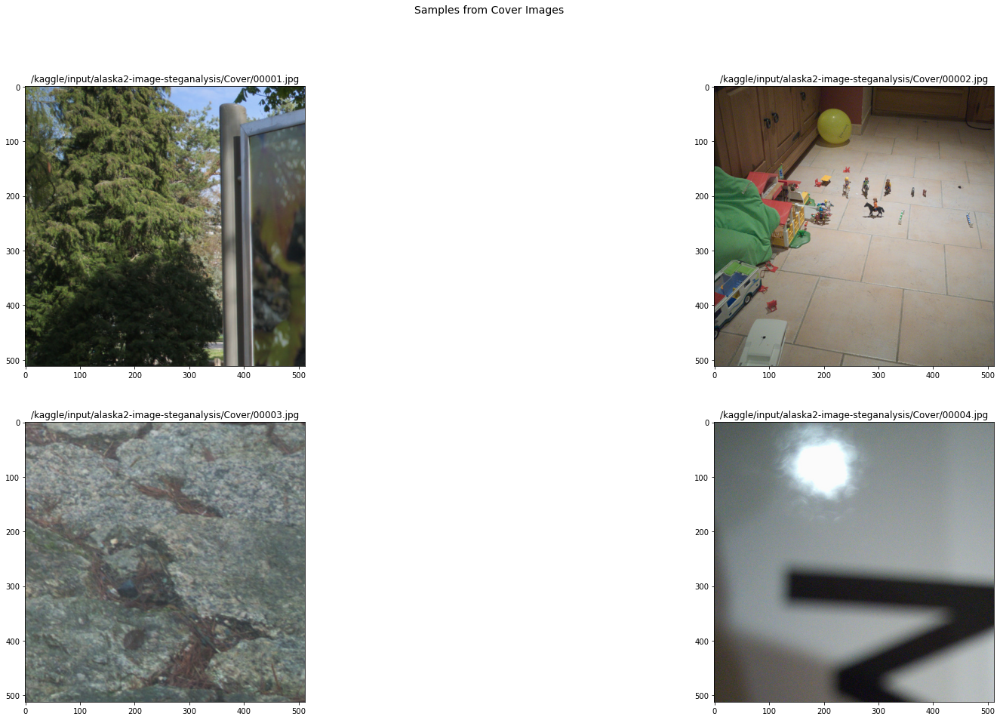

In [10]:
#Visualizing Some Images from Cover Section
fig,ax=plt.subplots(nrows=2,ncols=2,figsize=(30,15))
k=0
for i,row in enumerate(ax):
    for j,col in enumerate(row):
        img=sk.imread(cover_images_path[k])
        col.imshow(img)
        col.set_title(cover_images_path[k])
        k=k+1
plt.suptitle('Samples from Cover Images',fontsize=14)
plt.show()

# Visualizing Cover and Encoded side by side

Let's visualize cover image and encoded images side by side

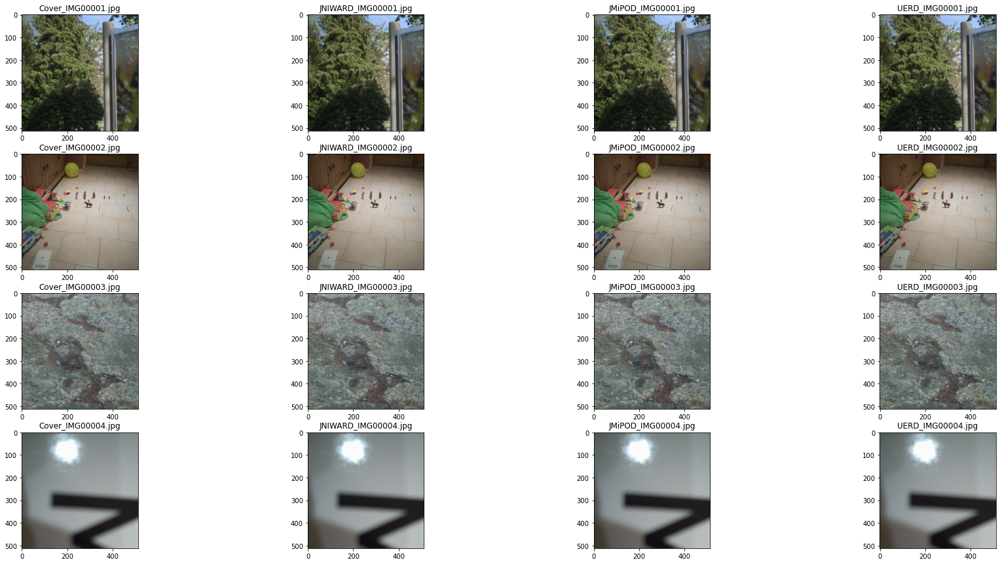

In [11]:
fig, ax = plt.subplots(nrows=4, ncols=4, figsize=(30, 15))
for i in range(4):
    '''
    If you want to print more images just change the values in range and ncols in subplot
    
    '''
    cvimg = sk.imread(cover_images_path[i])
    uniimg = sk.imread(JUNIWARD_images_path[i])
    jpodimg = sk.imread(JMIPOD_images_path[i])
    uerdimg = sk.imread(UERD_images_path[i])
    testimg=sk.imread(test_images_path[i])
    ax[i,0].imshow(cvimg)
    ax[i,0].set_title('Cover_IMG'+train_image[i])
    ax[i,1].imshow(uniimg)
    ax[i,1].set_title('JNIWARD_IMG'+train_image[i])
    ax[i,2].imshow(jpodimg)
    ax[i,2].set_title('JMiPOD_IMG'+train_image[i])
    ax[i,3].imshow(uerdimg)
    ax[i,3].set_title('UERD_IMG'+train_image[i])
    
    

I will try to do one final visualization of pixel deviation in the image channels.

# GroupKFold splitting


Group splitting by image_name is really important for correct validation.

In [12]:
%%time

dataset = []

for label, kind in enumerate(['Cover', 'JMiPOD', 'JUNIWARD', 'UERD']):
    for path in glob('../input/alaska2-image-steganalysis/Cover/*.jpg'):
        dataset.append({
            'kind': kind,
            'image_name': path.split('/')[-1],
            'label': label
        })

random.shuffle(dataset)
dataset = pd.DataFrame(dataset)

gkf = GroupKFold(n_splits=5)

dataset.loc[:, 'fold'] = 0
for fold_number, (train_index, val_index) in enumerate(gkf.split(X=dataset.index, y=dataset['label'], groups=dataset['image_name'])):
    dataset.loc[dataset.iloc[val_index].index, 'fold'] = fold_number


CPU times: user 4.14 s, sys: 0 ns, total: 4.14 s
Wall time: 4.14 s


In [13]:
def get_train_transforms():
    return A.Compose([
            A.HorizontalFlip(p=0.5),
            A.VerticalFlip(p=0.5),
            A.Resize(height=512, width=512, p=1.0),
            ToTensorV2(p=1.0),
        ], p=1.0)

def get_valid_transforms():
    return A.Compose([
            A.Resize(height=512, width=512, p=1.0),
            ToTensorV2(p=1.0),
        ], p=1.0)

In [14]:
DATA_ROOT_PATH = '../input/alaska2-image-steganalysis'

def onehot(size, target):
    vec = torch.zeros(size, dtype=torch.float32)
    vec[target] = 1.
    return vec

class DatasetRetriever(Dataset):

    def __init__(self, kinds, image_names, labels, transforms=None):
        super().__init__()
        self.kinds = kinds
        self.image_names = image_names
        self.labels = labels
        self.transforms = transforms

    def __getitem__(self, index: int):
        kind, image_name, label = self.kinds[index], self.image_names[index], self.labels[index]
        image = cv2.imread(f'{DATA_ROOT_PATH}/{kind}/{image_name}', cv2.IMREAD_COLOR)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB).astype(np.float32)
        image /= 255.0
        if self.transforms:
            sample = {'image': image}
            sample = self.transforms(**sample)
            image = sample['image']
            
        target = onehot(4, label)
        return image, target

    def __len__(self) -> int:
        return self.image_names.shape[0]

    def get_labels(self):
        return list(self.labels)



In [15]:
fold_number = 0

train_dataset = DatasetRetriever(
    kinds=dataset[dataset['fold'] != fold_number].kind.values,
    image_names=dataset[dataset['fold'] != fold_number].image_name.values,
    labels=dataset[dataset['fold'] != fold_number].label.values,
    transforms=get_train_transforms(),
)

validation_dataset = DatasetRetriever(
    kinds=dataset[dataset['fold'] == fold_number].kind.values,
    image_names=dataset[dataset['fold'] == fold_number].image_name.values,
    labels=dataset[dataset['fold'] == fold_number].label.values,
    transforms=get_valid_transforms(),
)

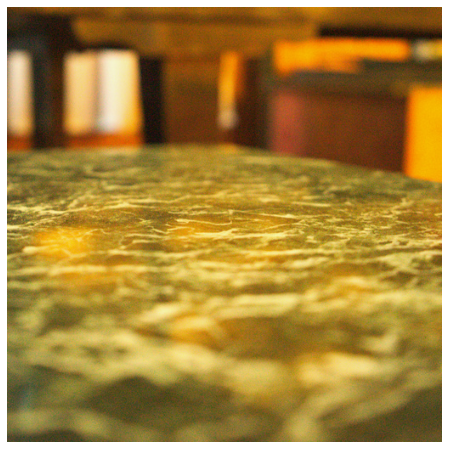

In [16]:
image, target = train_dataset[0]
numpy_image = image.permute(1,2,0).cpu().numpy()

fig, ax = plt.subplots(1, 1, figsize=(16, 8))
    
ax.set_axis_off()
ax.imshow(numpy_image);

# Metrics 

In [17]:
from sklearn import metrics

class AverageMeter(object):
    """Computes and stores the average and current value"""
    def __init__(self):
        self.reset()

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        self.val = val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count
        
        
def alaska_weighted_auc(y_true, y_valid):
    """
    https://www.kaggle.com/anokas/weighted-auc-metric-updated
    """
    tpr_thresholds = [0.0, 0.4, 1.0]
    weights = [2, 1]

    fpr, tpr, thresholds = metrics.roc_curve(y_true, y_valid, pos_label=1)

    # size of subsets
    areas = np.array(tpr_thresholds[1:]) - np.array(tpr_thresholds[:-1])

    # The total area is normalized by the sum of weights such that the final weighted AUC is between 0 and 1.
    normalization = np.dot(areas, weights)

    competition_metric = 0
    for idx, weight in enumerate(weights):
        y_min = tpr_thresholds[idx]
        y_max = tpr_thresholds[idx + 1]
        mask = (y_min < tpr) & (tpr < y_max)
        # pdb.set_trace()

        x_padding = np.linspace(fpr[mask][-1], 1, 100)

        x = np.concatenate([fpr[mask], x_padding])
        y = np.concatenate([tpr[mask], [y_max] * len(x_padding)])
        y = y - y_min  # normalize such that curve starts at y=0
        score = metrics.auc(x, y)
        submetric = score * weight
        best_subscore = (y_max - y_min) * weight
        competition_metric += submetric

    return competition_metric / normalization
        
class RocAucMeter(object):
    def __init__(self):
        self.reset()

    def reset(self):
        self.y_true = np.array([0,1])
        self.y_pred = np.array([0.5,0.5])
        self.score = 0

    def update(self, y_true, y_pred):
        y_true = y_true.cpu().numpy().argmax(axis=1).clip(min=0, max=1).astype(int)
        y_pred = 1 - nn.functional.softmax(y_pred, dim=1).data.cpu().numpy()[:,0]
        self.y_true = np.hstack((self.y_true, y_true))
        self.y_pred = np.hstack((self.y_pred, y_pred))
        self.score = alaska_weighted_auc(self.y_true, self.y_pred)
    
    @property
    def avg(self):
        return self.score


# Label Smoothing

In [18]:
class LabelSmoothing(nn.Module):
    def __init__(self, smoothing = 0.05):
        super(LabelSmoothing, self).__init__()
        self.confidence = 1.0 - smoothing
        self.smoothing = smoothing

    def forward(self, x, target):
        if self.training:
            x = x.float()
            target = target.float()
            logprobs = torch.nn.functional.log_softmax(x, dim = -1)

            nll_loss = -logprobs * target
            nll_loss = nll_loss.sum(-1)
    
            smooth_loss = -logprobs.mean(dim=-1)

            loss = self.confidence * nll_loss + self.smoothing * smooth_loss

            return loss.mean()
        else:
            return torch.nn.functional.cross_entropy(x, target)

# Filter

In [19]:
import warnings

warnings.filterwarnings("ignore")

class Fitter:
    
    def __init__(self, model, device, config):
        self.config = config
        self.epoch = 0
        
        self.base_dir = './'
        self.log_path = f'{self.base_dir}/log.txt'
        self.best_summary_loss = 10**5

        self.model = model
        self.device = device

        param_optimizer = list(self.model.named_parameters())
        no_decay = ['bias', 'LayerNorm.bias', 'LayerNorm.weight']
        optimizer_grouped_parameters = [
            {'params': [p for n, p in param_optimizer if not any(nd in n for nd in no_decay)], 'weight_decay': 0.001},
            {'params': [p for n, p in param_optimizer if any(nd in n for nd in no_decay)], 'weight_decay': 0.0}
        ] 

        self.optimizer = torch.optim.AdamW(self.model.parameters(), lr=config.lr)
        self.scheduler = config.SchedulerClass(self.optimizer, **config.scheduler_params)
        self.criterion = LabelSmoothing().to(self.device)
        self.log(f'Fitter prepared. Device is {self.device}')

    def fit(self, train_loader, validation_loader):
        for e in range(self.config.n_epochs):
            if self.config.verbose:
                lr = self.optimizer.param_groups[0]['lr']
                timestamp = datetime.utcnow().isoformat()
                self.log(f'\n{timestamp}\nLR: {lr}')

            t = time.time()
            summary_loss, final_scores = self.train_one_epoch(train_loader)

            self.log(f'[RESULT]: Train. Epoch: {self.epoch}, summary_loss: {summary_loss.avg:.5f}, final_score: {final_scores.avg:.5f}, time: {(time.time() - t):.5f}')
            self.save(f'{self.base_dir}/last-checkpoint.bin')

            t = time.time()
            summary_loss, final_scores = self.validation(validation_loader)

            self.log(f'[RESULT]: Val. Epoch: {self.epoch}, summary_loss: {summary_loss.avg:.5f}, final_score: {final_scores.avg:.5f}, time: {(time.time() - t):.5f}')
            if summary_loss.avg < self.best_summary_loss:
                self.best_summary_loss = summary_loss.avg
                self.model.eval()
                self.save(f'{self.base_dir}/best-checkpoint-{str(self.epoch).zfill(3)}epoch.bin')
                for path in sorted(glob(f'{self.base_dir}/best-checkpoint-*epoch.bin'))[:-3]:
                    os.remove(path)

            if self.config.validation_scheduler:
                self.scheduler.step(metrics=summary_loss.avg)

            self.epoch += 1

    def validation(self, val_loader):
        self.model.eval()
        summary_loss = AverageMeter()
        final_scores = RocAucMeter()
        t = time.time()
        for step, (images, targets) in enumerate(val_loader):
            if self.config.verbose:
                if step % self.config.verbose_step == 0:
                    print(
                        f'Val Step {step}/{len(val_loader)}, ' + \
                        f'summary_loss: {summary_loss.avg:.5f}, final_score: {final_scores.avg:.5f}, ' + \
                        f'time: {(time.time() - t):.5f}', end='\r'
                    )
            with torch.no_grad():
                targets = targets.to(self.device).float()
                batch_size = images.shape[0]
                images = images.to(self.device).float()
                outputs = self.model(images)
                loss = self.criterion(outputs, targets)
                final_scores.update(targets, outputs)
                summary_loss.update(loss.detach().item(), batch_size)

        return summary_loss, final_scores

    def train_one_epoch(self, train_loader):
        self.model.train()
        summary_loss = AverageMeter()
        final_scores = RocAucMeter()
        t = time.time()
        for step, (images, targets) in enumerate(train_loader):
            if self.config.verbose:
                if step % self.config.verbose_step == 0:
                    print(
                        f'Train Step {step}/{len(train_loader)}, ' + \
                        f'summary_loss: {summary_loss.avg:.5f}, final_score: {final_scores.avg:.5f}, ' + \
                        f'time: {(time.time() - t):.5f}', end='\r'
                    )
            
            targets = targets.to(self.device).float()
            images = images.to(self.device).float()
            batch_size = images.shape[0]

            self.optimizer.zero_grad()
            outputs = self.model(images)
            loss = self.criterion(outputs, targets)
            loss.backward()
            
            final_scores.update(targets, outputs)
            summary_loss.update(loss.detach().item(), batch_size)

            self.optimizer.step()

            if self.config.step_scheduler:
                self.scheduler.step()

        return summary_loss, final_scores
    
    def save(self, path):
        self.model.eval()
        torch.save({
            'model_state_dict': self.model.state_dict(),
            'optimizer_state_dict': self.optimizer.state_dict(),
            'scheduler_state_dict': self.scheduler.state_dict(),
            'best_summary_loss': self.best_summary_loss,
            'epoch': self.epoch,
        }, path)

    def load(self, path):
        checkpoint = torch.load(path)
        self.model.load_state_dict(checkpoint['model_state_dict'])
        self.optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        self.scheduler.load_state_dict(checkpoint['scheduler_state_dict'])
        self.best_summary_loss = checkpoint['best_summary_loss']
        self.epoch = checkpoint['epoch'] + 1
        
    def log(self, message):
        if self.config.verbose:
            print(message)
        with open(self.log_path, 'a+') as logger:
            logger.write(f'{message}\n')

# EfficientNet

In [20]:
from efficientnet_pytorch import EfficientNet

def get_net():
    net = EfficientNet.from_pretrained('efficientnet-b2')
    net._fc = nn.Linear(in_features=1408, out_features=4, bias=True)
    return net

net = get_net().cuda()

Downloading: "https://github.com/lukemelas/EfficientNet-PyTorch/releases/download/1.0/efficientnet-b2-8bb594d6.pth" to /root/.cache/torch/checkpoints/efficientnet-b2-8bb594d6.pth



Loaded pretrained weights for efficientnet-b2


In [21]:
class TrainGlobalConfig:
    num_workers = 4
    batch_size = 16 
    n_epochs = 25
    lr = 0.001

    # -------------------
    verbose = True
    verbose_step = 1
    # -------------------

    # --------------------
    step_scheduler = False  # do scheduler.step after optimizer.step
    validation_scheduler = True  # do scheduler.step after validation stage loss

#     SchedulerClass = torch.optim.lr_scheduler.OneCycleLR
#     scheduler_params = dict(
#         max_lr=0.001,
#         epochs=n_epochs,
#         steps_per_epoch=int(len(train_dataset) / batch_size),
#         pct_start=0.1,
#         anneal_strategy='cos', 
#         final_div_factor=10**5
#     )
    
    SchedulerClass = torch.optim.lr_scheduler.ReduceLROnPlateau
    scheduler_params = dict(
        mode='min',
        factor=0.5,
        patience=1,
        verbose=False, 
        threshold=0.0001,
        threshold_mode='abs',
        cooldown=0, 
        min_lr=1e-8,
        eps=1e-08
    )
    # -----------------

In [22]:
from catalyst.data.sampler import BalanceClassSampler

def run_training():
    device = torch.device('cuda:0')

    train_loader = torch.utils.data.DataLoader(
        train_dataset,
        sampler=BalanceClassSampler(labels=train_dataset.get_labels(), mode="downsampling"),
        batch_size=TrainGlobalConfig.batch_size,
        pin_memory=False,
        drop_last=True,
        num_workers=TrainGlobalConfig.num_workers,
    )
    val_loader = torch.utils.data.DataLoader(
        validation_dataset, 
        batch_size=TrainGlobalConfig.batch_size,
        num_workers=TrainGlobalConfig.num_workers,
        shuffle=False,
        sampler=SequentialSampler(validation_dataset),
        pin_memory=False,
    )

    fitter = Fitter(model=net, device=device, config=TrainGlobalConfig)
#     fitter.load(f'{fitter.base_dir}/last-checkpoint.bin')
    fitter.fit(train_loader, val_loader)

wandb: WARNING W&B installed but not logged in.  Run `wandb login` or set the WANDB_API_KEY env variable.


# Training 

In [23]:
file = open('../input/alaska2-public-baseline/log.txt', 'r')
for line in file.readlines():
    print(line[:-1])
file.close()

Fitter prepared. Device is cuda:0

2020-05-29T19:09:38.978059
LR: 0.001
[RESULT]: Train. Epoch: 0, summary_loss: 1.12148, final_score: 0.75808, time: 5751.84601
[RESULT]: Val. Epoch: 0, summary_loss: 1.05822, final_score: 0.78976, time: 345.36683

2020-05-29T20:51:16.774264
LR: 0.001
[RESULT]: Train. Epoch: 1, summary_loss: 1.03318, final_score: 0.78997, time: 5739.52804
[RESULT]: Val. Epoch: 1, summary_loss: 1.00851, final_score: 0.80288, time: 345.85826

2020-05-29T22:32:42.607439
LR: 0.001
[RESULT]: Train. Epoch: 2, summary_loss: 1.01009, final_score: 0.79796, time: 5743.44489
[RESULT]: Val. Epoch: 2, summary_loss: 1.00570, final_score: 0.79977, time: 345.89039

2020-05-30T00:14:12.399999
LR: 0.001
[RESULT]: Train. Epoch: 3, summary_loss: 0.99827, final_score: 0.80149, time: 5741.83880
[RESULT]: Val. Epoch: 3, summary_loss: 1.01907, final_score: 0.79848, time: 345.65748

2020-05-30T01:55:40.159264
LR: 0.001
[RESULT]: Train. Epoch: 4, summary_loss: 0.98873, final_score: 0.80554, time

# Inference

In [24]:
checkpoint = torch.load('../input/alaska2-public-baseline/best-checkpoint-033epoch.bin')
net.load_state_dict(checkpoint['model_state_dict']);
net.eval();

In [25]:
checkpoint.keys()

dict_keys(['model_state_dict', 'optimizer_state_dict', 'scheduler_state_dict', 'best_summary_loss', 'epoch'])

In [26]:
class DatasetSubmissionRetriever(Dataset):

    def __init__(self, image_names, transforms=None):
        super().__init__()
        self.image_names = image_names
        self.transforms = transforms

    def __getitem__(self, index: int):
        image_name = self.image_names[index]
        image = cv2.imread(f'{DATA_ROOT_PATH}/Test/{image_name}', cv2.IMREAD_COLOR)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB).astype(np.float32)
        image /= 255.0
        if self.transforms:
            sample = {'image': image}
            sample = self.transforms(**sample)
            image = sample['image']

        return image_name, image

    def __len__(self) -> int:
        return self.image_names.shape[0]

In [27]:
dataset = DatasetSubmissionRetriever(
    image_names=np.array([path.split('/')[-1] for path in glob('../input/alaska2-image-steganalysis/Test/*.jpg')]),
    transforms=get_valid_transforms(),
)


data_loader = DataLoader(
    dataset,
    batch_size=8,
    shuffle=False,
    num_workers=2,
    drop_last=False,
)


In [28]:
%%time

result = {'Id': [], 'Label': []}
for step, (image_names, images) in enumerate(data_loader):
    print(step, end='\r')
    
    y_pred = net(images.cuda())
    y_pred = 1 - nn.functional.softmax(y_pred, dim=1).data.cpu().numpy()[:,0]
    
    result['Id'].extend(image_names)
    result['Label'].extend(y_pred)

CPU times: user 36.7 s, sys: 8.61 s, total: 45.3 s
Wall time: 1min 6s


In [29]:
submission = pd.DataFrame(result)
submission.to_csv('submission.csv', index=False)
submission.head()

,Id,Label
0,4642.jpg,0.987929
1,1846.jpg,0.513460
2,0608.jpg,0.137510
3,0639.jpg,0.799995
4,4185.jpg,0.377910


**Please upvote !!!**